In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch_TST.model.TST import PatchTST_backbone
from torch.utils.data import Dataset, DataLoader
from torch_TST.layer.utils import *
from torch_TST.layer.data_get import *
from torch.optim import Adam
from tqdm.auto import tqdm
device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")
data_features_dict = {
    "ELBSL4-12570S机组系统_L4-125S压缩机组_01#压缩机_压缩机1能级状态": "cpr1",
    "ELBSL4-12570S机组系统_L4-125S压缩机组_02#压缩机_压缩机2能级状态": "cpr2",
    "ELBSL4-12570S机组系统_L4-125S压缩机组_03#压缩机_压缩机3能级状态": "cpr3",
    "ELBSL4-12570S机组系统_L4-70S压缩机组_04#压缩机_压缩机4能级状态": "cpr4",
    "ELBSL4-12570S机组系统_L4冷凝设备组_01#水泵_蒸发冷水泵": "cdr_pump",
    "ELBSL4-12570S机组系统_L4冷凝设备组_01#风机_蒸发冷风机1": "cdr_fan1",
    "ELBSL4-12570S机组系统_L4冷凝设备组_02#风机_蒸发冷风机2": "cdr_fan2",
    "ELBSL4-12570S机组系统_L4冷凝设备组_03#风机_蒸发冷风机3": "cdr_fan3",
    "ELBSL4-12570S机组系统_L4-125S压缩机组_冷冻吸气压力": "in_pa",
    "ELBSL4-12570S机组系统_L4-125S压缩机组_冷冻吸气温度": "in_temp",
    "ELBSL4-12570S机组系统_L4-125S压缩机组_排气压力": "ex_pa",
    "ELBSL4-12570S机组系统_L4-125S压缩机组_供液温度": "liq_temp",
    "ELBSL4-12570S机组系统_L4-125S压缩机组_排气温度": "ex_temp",
    "ELBSL4-12570S机组系统_L4-125S压缩机组_环境温度": "env_temp",
    "3#冷冻库_01#风机_风机状态": "fre3_fan1",
    "冷藏库_01#风机_风机状态": "refr_fan",
    "1#冷冻库_01#风机_风机状态": "fre1_fan1",
    "2#冷冻库_01#风机_风机状态": "fre2_fan1",
    "3#冷冻库_02#风机_风机状态": "fre3_fan2",
    "冷藏库_02#风机_风机状态": "refr_fan2",
    "1#冷冻库_02#风机_风机状态": "fre1_fan2",
    "2#冷冻库_02#风机_风机状态": "fre2_fan2",
    "月台_01#02#风机_风机状态": "pf_fan12",
    "1#冷冻库_03#风机_风机状态": "fre1_fan3",
    "2#冷冻库_03#风机_风机状态": "fre2_fan3",
    "3#冷冻库_03#风机_风机状态": "fre3_fan3",
    "月台_03#04#风机_风机状态": "pf_fan34",
    "3#冷冻库_04#风机_风机状态": "fre3_fan4",
    "1#冷冻库_04#风机_风机状态": "fre1_fan4",
    "2#冷冻库_04#风机_风机状态": "fre2_fan4",
    "1#冷冻库_05#风机_风机状态": "fre1_fan5",
    "月台_05#06#风机_风机状态": "pf_fan56",
    "1#冷冻库_06#风机_风机状态": "fre1_fan6",
    "1#冷冻库_冷冻1_传感器1温度": "fre1_temp1",
    "1#冷冻库_冷冻1_传感器2温度": "fre1_temp2",
    "1#冷冻库_冷冻1_传感器3温度": "fre1_temp3",
    "1#冷冻库_冷冻1_传感器4温度": "fre1_temp4",
    "1#冷冻库_冷冻1_传感器5温度": "fre1_temp5",
    "1#冷冻库_冷冻1_传感器6温度": "fre1_temp6",
    "1#冷冻库_冷冻1_平均温度": "fre1_temp_avg",
    "2#冷冻库_冷冻库2门1_冷冻库2门1": "fre2_door1",
    "2#冷冻库_冷冻库2门2_冷冻库2门2": "fre2_door2",
    "2#冷冻库_冷冻库2门3_冷冻库2门3": "fre2_door3",
    "2#冷冻库_冷冻2_传感器1温度": "fre2_temp1",
    "2#冷冻库_冷冻2_传感器2温度": "fre2_temp2",
    "2#冷冻库_冷冻2_传感器3温度": "fre2_temp3",
    "2#冷冻库_冷冻2_传感器4温度": "fre2_temp4",
    "2#冷冻库_冷冻2_平均温度": "fre2_temp_avg",
    "3#冷冻库_冷冻3_传感器1温度": "fre3_temp1",
    "3#冷冻库_冷冻3_传感器2温度": "fre3_temp2",
    "3#冷冻库_冷冻3_传感器3温度": "fre3_temp3",
    "3#冷冻库_冷冻3_传感器4温度": "fre3_temp4",
    "3#冷冻库_冷冻3_平均温度": "fre3_temp_avg",
    "ELBSL4-12570S机组系统_其他_L4机组电表_L4机组_Psum": "kw",
    "1#冷冻库_冷冻1_温度设定上限": "fre1_temp_up",
    "1#冷冻库_冷冻1_温度设定下限": "fre1_temp_low",
    "2#冷冻库_冷冻2_温度设定上限": "fre2_temp_up",
    "2#冷冻库_冷冻2_温度设定下限": "fre2_temp_low",
    "3#冷冻库_冷冻3_温度设定上限": "fre3_temp_up",
    "3#冷冻库_冷冻3_温度设定下限": "fre3_temp_low"
}
features = [
    'ELBSL4-12570S机组系统_其他_L4机组电表_L4机组_Psum',
    'ELBSL4-12570S机组系统_L4冷凝设备组_01#水泵_蒸发冷水泵',
    'ELBSL4-12570S机组系统_L4冷凝设备组_01#风机_蒸发冷风机1',
    '1#冷冻库_05#风机_风机状态',
    'ELBSL4-12570S机组系统_L4-125S压缩机组_03#压缩机_压缩机3能级状态',
    'ELBSL4-12570S机组系统_L4-125S压缩机组_01#压缩机_压缩机1能级状态',
    '1#冷冻库_03#风机_风机状态',
    'ELBSL4-12570S机组系统_L4-125S压缩机组_02#压缩机_压缩机2能级状态',
]
plt.rcParams['font.sans-serif'] = 'SimHei'
plt.rcParams['axes.unicode_minus'] = False
features_code =[]
for feature in features: # 特征的字母表示
    features_code.append(data_features_dict[feature])
df = pd.read_csv(r"..\data\data_wh1_1hour.csv", index_col=0, parse_dates=['time'])
def add_time_features(df):
    df['hour'] = df.index.hour
    df['day_of_week'] = df.index.dayofweek
    df['day_of_month'] = df.index.day
    df['month'] = df.index.month
    return df
features_code.append('hour')
features_code.append('day_of_week')
features_code.append('day_of_month')
features_code.append('month')
df = add_time_features(df)

In [2]:
input_len = 7*24
output_len  = 1*24
c_in = df.shape[1]

小波降噪test

In [4]:
kw_raw = df['kw']
kw_denoised = wavelet_denoise_high_freq(kw_raw) 
kw_denoised = kw_denoised[:-1] # 降噪后的数据对齐
for i in range(df.shape[0]):
    df['kw'].iloc[i] = kw_denoised[i] # 用降噪后的kw替换input中原始数据
kw_denoised_withindex = pd.Series(kw_denoised,index=kw_raw.index)
show_labelperdict(kw_raw,kw_denoised_withindex)

C:\Users\ZY\AppData\Local\Temp\ipykernel_1020\365910548.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['kw'].iloc[i] = kw_denoised[i] # 用降噪后的kw替换input中原始数据
C:\Users\ZY\AppData\Local\Temp\ipykernel_1020\365910548.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['kw'].iloc[i] = kw_denoised[i] # 用降噪后的kw替换input中原始数据
C:\Users\ZY\AppData\Local\Temp\ipykernel_1020\365910548.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[

In [3]:
train_loader,test_loader = give_me_wavelet_dataloader(df,input_len,output_len)

D:\PYCODE\TS\torch_TST\layer\data_get.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['kw'].iloc[i] = kw_denoised[i]
D:\PYCODE\TS\torch_TST\layer\data_get.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['kw'].iloc[i] = kw_denoised[i]
D:\PYCODE\TS\torch_TST\layer\data_get.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['kw'].iloc[i] = kw_denoised[i]
D:\PYCODE\TS\torch_TST\layer\data_get.py:30: SettingWithCopyWarn

In [4]:
@torch.no_grad()
def evaluating(model, dataloader, loss_fct=None):
    """ TST的端口数据均为(bs,features,len) --- permute
    default with mape
    return one scalar
    """
    loss_list = []
    # perdict_list = []
    for x,labes in dataloader:
        x = x.to(device)
        x = x.permute(0,2,1)
        labes = labes.to(device)
        perdicts = model(x).to(device)
        perdicts = perdicts.permute(0,2,1)
        perdicts = perdicts[:,:,0]
        labes = labes[:,:,0]
        if loss_fct is not None:
            loss = loss_fct(perdicts,labes)         # 验证集损失
        else:
            loss = mape_loss(perdicts,labes)
        loss_list.append(loss.cpu().item())
        # labels_1d = labes.view(-1)
        # perdict = perdicts[:,0,:]
        # p = perdict.view(-1)
        # perdict_list.append(p.cpu().item())

    return np.mean(loss_list)
    # return loss_list
@torch.no_grad()
def predict_tstbackbone(model, dataloader):
    """ TST的端口数据均为(bs,features,len) --- permute
    return one list
    """
    perdict_list = []
    for x,labes in dataloader:
        x = x.to(device)
        x = x.permute(0,2,1)
        perdicts = model(x).to(device)
        perdicts = perdicts.permute(0,2,1)
        perdicts = perdicts[:,:,0]
        p = perdicts.squeeze(1)
        perdict_list.append(p)
    return perdict_list

In [5]:
def training(
    model,
    train_loader,
    val_loader,
    epoch,
    loss_fct,
    optimizer,
    scheduler=None,
    tensorboard_callback=None,
    save_ckpt_callback=None,
    early_stop_callback=None,
    eval_step=500,
    ):
    record_dict = {
        "train": [],
        "val": []
    }
    global_step = 1
    model.train()
    with tqdm(total=epoch * len(train_loader)) as pbar:
        for epoch_id in range(epoch):
            # training
            for x,y in train_loader:
                x = x.to(device)
                y = y.to(device)
                # 梯度清空
                x = x.permute(0,2,1)
                # y = y.permute(0,2,1)
                optimizer.zero_grad()
                # 前向计算
                pedicts = model(x)
                pedicts =pedicts.permute(0,2,1)
                pedicts = pedicts[:,:,0].unsqueeze(-1)
                loss = loss_fct(pedicts,y)

                # 梯度回传
                loss.backward()

                # 调整优化器，包括学习率的变动等
                optimizer.step()
                if scheduler is not None:
                    scheduler.step() # 更新学习率

                loss = loss.cpu().item()
                # record
                record_dict["train"].append({
                    "loss": loss, "step": global_step
                })

                # evaluating
                if global_step % eval_step == 0:
                    # model.eval()
                    # val_loss = evaluating(model, val_loader, loss_fct)
                    # record_dict["val"].append({
                    #     "loss": val_loss, "step": global_step
                    # })
                    # model.train()

                    # 1. 使用 tensorboard 可视化
                    # cur_lr = optimizer.param_groups[0]["lr"] if scheduler is None else scheduler.get_last_lr()[0]
                    # if tensorboard_callback is not None:
                    #     tensorboard_callback(
                    #         global_step,
                    #         loss=loss, val_loss=val_loss,
                    #         lr=cur_lr,
                    #         )
                    #
                    # # 2. 保存模型权重 save model checkpoint
                    # if save_ckpt_callback is not None:
                    #     save_ckpt_callback(global_step, model.state_dict(), metric=-val_loss)

                    # 3. 早停 Early Stop
                    if early_stop_callback is not None:
                        early_stop_callback(-loss)
                        if early_stop_callback.early_stop:
                            print(f"Early stop at epoch {epoch_id} / global_step {global_step}")
                            return record_dict

                # udate step
                global_step += 1
                pbar.update(1)
                pbar.set_postfix({"epoch": epoch_id})

    return record_dict

In [6]:
model = PatchTST_backbone(c_in=c_in,context_window=input_len,target_window=output_len,patch_len=output_len,stride=8).to(device)

In [7]:
early_stop = EarlyStopCallback()
optimizer = Adam(params=model.parameters(), lr=1e-5, weight_decay=5e-3, eps=5e-9)
loss_f = nn.MSELoss()

In [8]:
record = training(model=model,train_loader=train_loader,val_loader=test_loader,
                  epoch=10,loss_fct=loss_f,optimizer=optimizer)

  0%|          | 0/2050 [00:00<?, ?it/s]

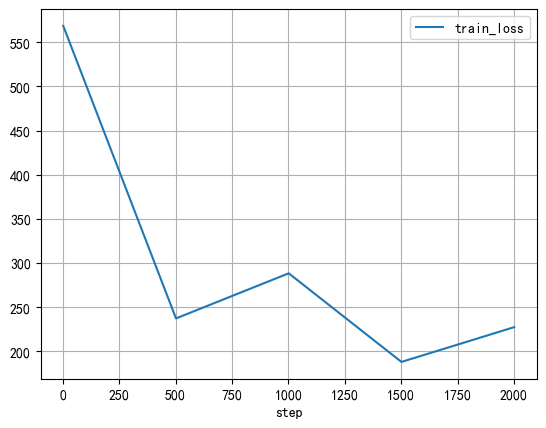

In [9]:
plot_learning_curves(record)

In [12]:
model.eval()
loss = evaluating(model, test_loader,loss_f)
print(f"loss:     {loss:.4f}")

loss:     974.8448


In [11]:
model.eval()
loss = evaluating(model, test_loader,mape_loss)
print(f"loss:     {loss:.4f}")  

loss:     18.1108


In [13]:
model.eval()
loss = evaluating(model, test_loader,loss_f)

In [13]:
loss = torch.tensor(loss)
print(f"loss:     {torch.sqrt(loss):.4f}")

loss:     31.2225


In [ ]:
from torch_TST.model import LSTM


In [15]:
@torch.no_grad()
def predict_tstbackbone(model, dataloader):
    perdict_list = []
    label_list = []
    for x,labes in dataloader:
        x = x.to(device)
        x = x.permute(0,2,1)
        perdicts = model(x).to(device)
        perdicts = perdicts.permute(0,2,1)
        perdicts = perdicts[:,:,0]
        p = perdicts.squeeze(1)
        perdict_list.append(p[0][0].item())
    return perdict_list

In [16]:
perdict_tstbackbone = predict_tstbackbone(model,test_loader)

In [17]:
label = []
for _,i in test_loader:
    label.append(i[0][0].item())

In [32]:
exp = [label[0:24],perdict_tstbackbone[0:24]]

In [38]:
label

[86.16288757324219,
 83.79764556884766,
 82.80010223388672,
 81.45877075195312,
 86.0216064453125,
 77.10417175292969,
 73.7951431274414,
 98.75625610351562,
 80.8300552368164,
 92.08245849609375,
 92.2793960571289,
 95.60803985595703,
 101.78564453125,
 112.42378234863281,
 119.8058853149414,
 104.880126953125,
 78.84417724609375,
 79.58293151855469,
 100.1455307006836,
 107.31449890136719,
 108.10934448242188,
 118.94082641601562,
 127.25035095214844,
 116.27584838867188,
 96.92615509033203,
 95.62120056152344,
 105.22905731201172,
 98.72993469238281,
 85.99409484863281,
 91.94876861572266,
 89.53389739990234,
 82.4400634765625,
 76.64686584472656,
 110.87236022949219,
 91.82969665527344,
 114.16822052001953,
 121.70702362060547,
 120.28352355957031,
 122.21967315673828,
 110.92951965332031,
 102.2329330444336,
 109.48701477050781,
 130.41334533691406,
 146.016357421875,
 153.42019653320312,
 151.8577880859375,
 136.32420349121094,
 123.52345275878906,
 113.11480712890625,
 100.23851

In [35]:
perdict_tstbackbone[0:24]

[92.87737274169922,
 83.20128631591797,
 81.78264617919922,
 76.92631530761719,
 79.2392349243164,
 82.62213897705078,
 75.2655258178711,
 72.57566833496094,
 76.4814682006836,
 79.89435577392578,
 76.73965454101562,
 84.92532348632812,
 84.0352554321289,
 95.64086151123047,
 99.40946197509766,
 102.59877014160156,
 95.6097412109375,
 92.60799407958984,
 95.57716369628906,
 98.5333480834961,
 93.54371643066406,
 101.9674072265625,
 104.69792175292969,
 105.58907318115234]

In [41]:
r2 = r2_score(torch.Tensor(label[0:]),torch.Tensor(perdict_tstbackbone[0:]))
print(r2)

tensor(0.5111)


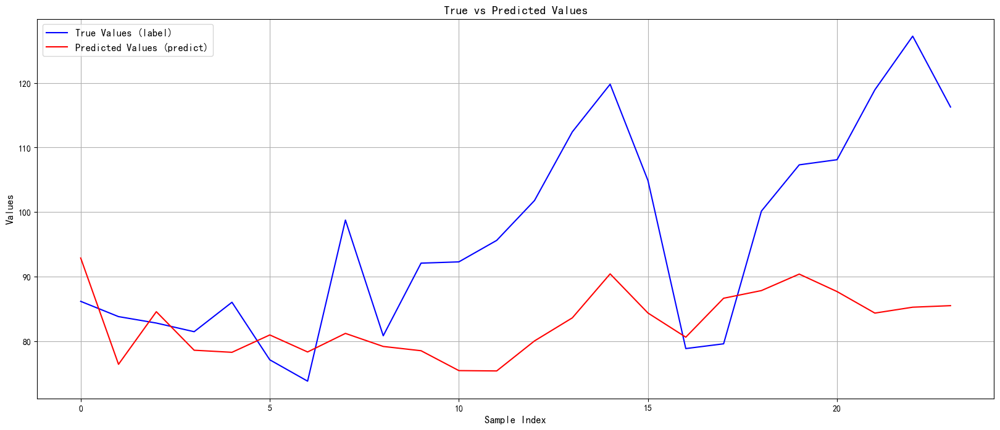

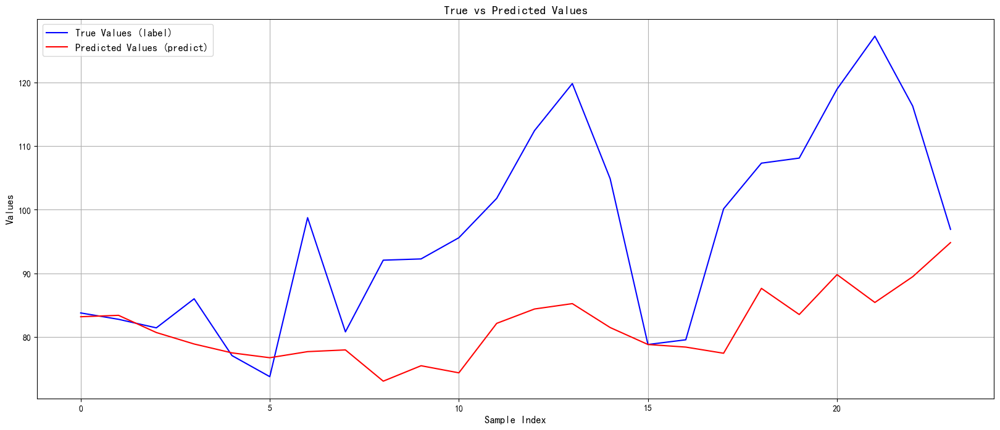

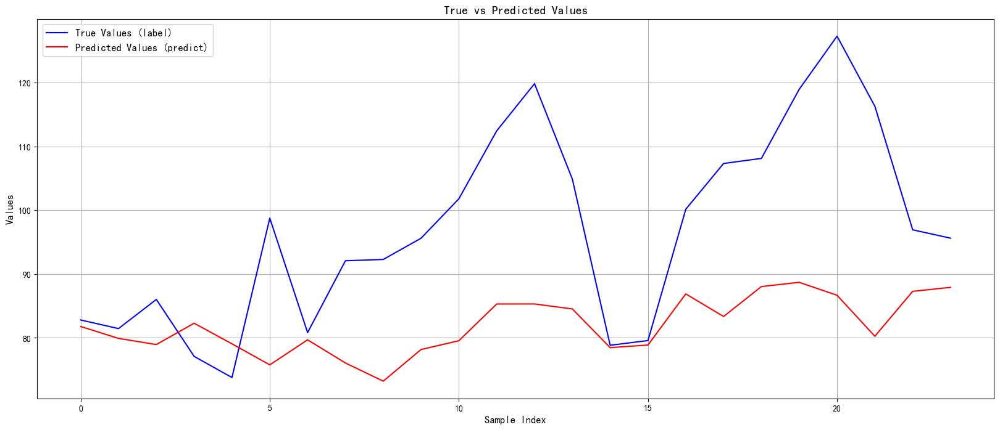

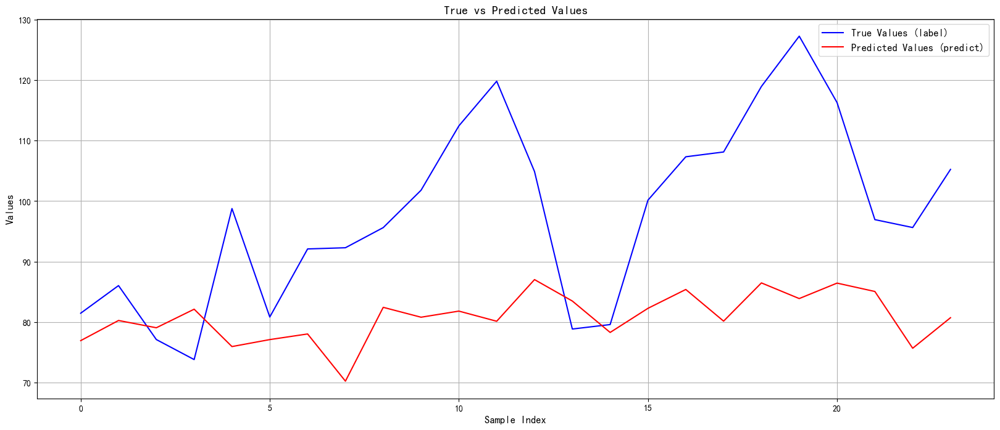

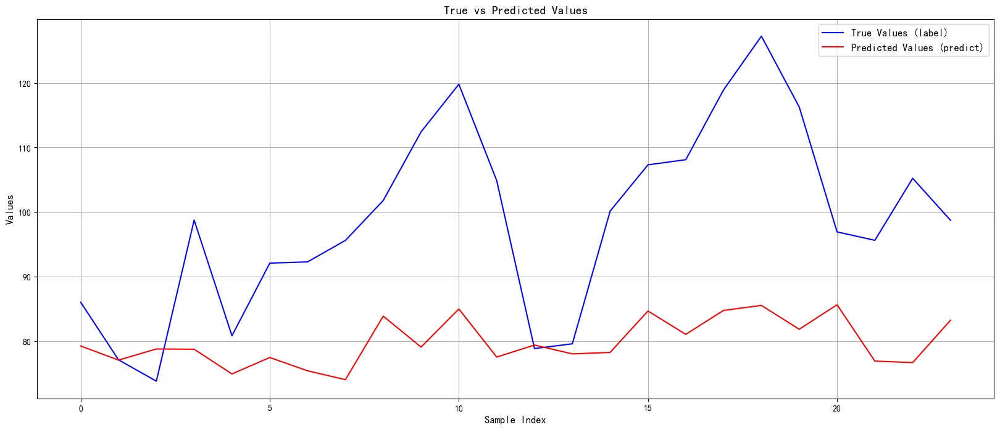

...

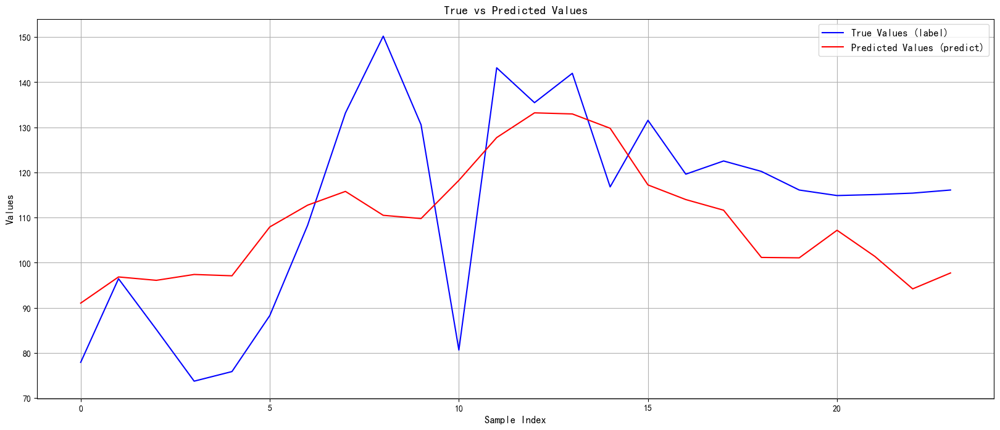

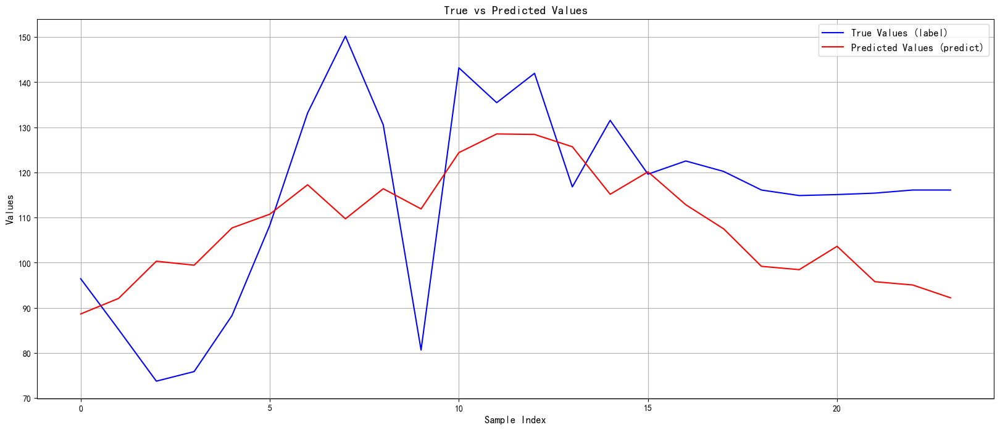

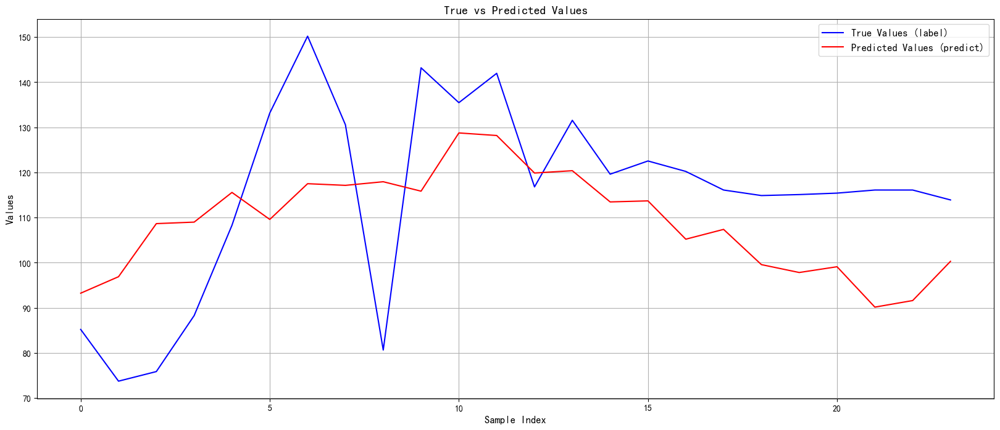

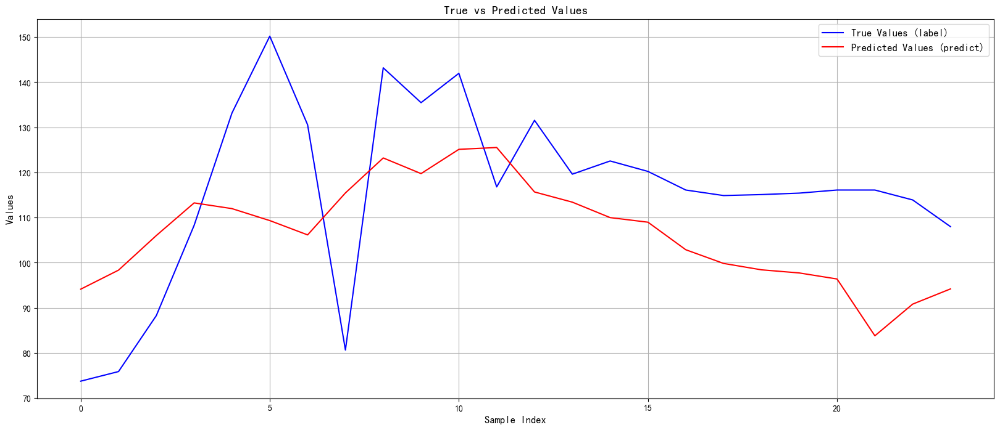

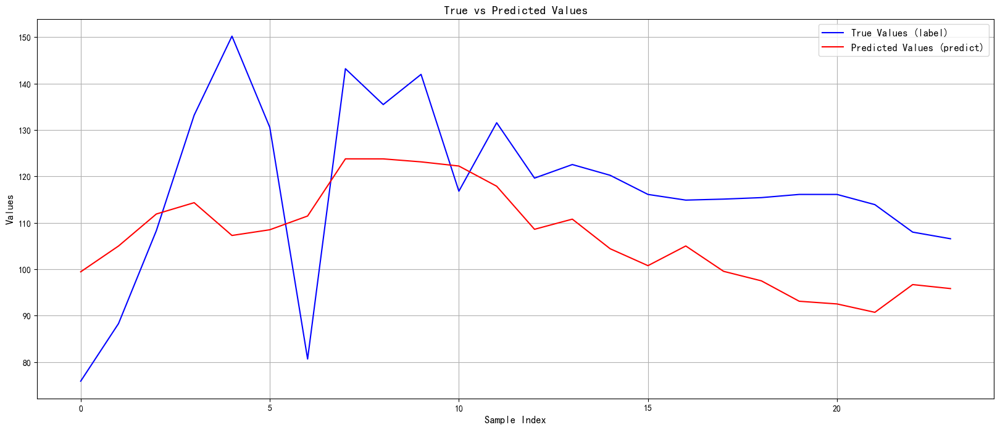

KeyboardInterrupt: 

In [52]:
for x,y in test_loader:
    x = x.permute(0,2,1).to(device)
    p = model(x).to(device)
    p = p.permute(0,2,1)
    p = p[:,:,0].cpu().detach().numpy()
    y = y[:,:,0].cpu().detach().numpy()
    p = p.reshape(-1)
    y = y.reshape(-1)
    pl = []
    ll = []
    for i,j in zip(p,y):
        pl.append(i)
        ll.append(j)
    show_labelperdict(ll,pl)


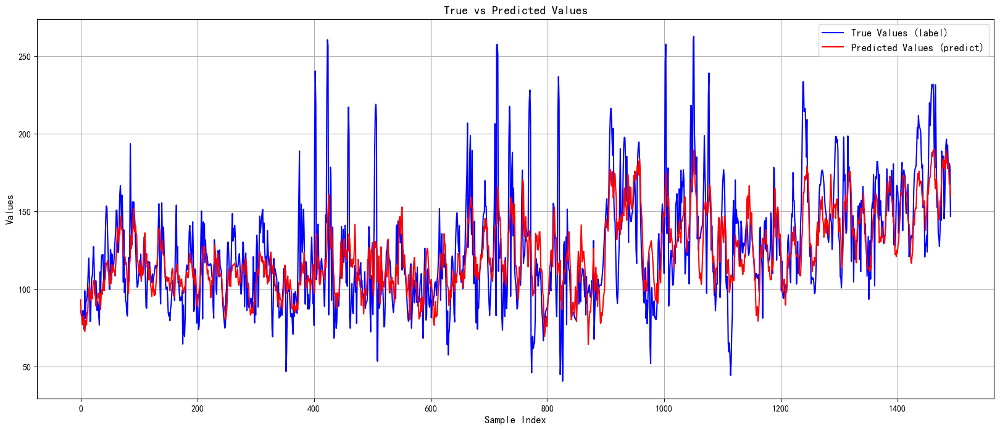

In [18]:
def show_labelperdict(label,predict):
    # 绘制图表
    plt.figure(figsize=(20, 8))
    plt.plot(label, label='True Values (label)',color='blue')  # 折线图表示真实值
    plt.plot(predict, label='Predicted Values (predict)', color='red')  # 折线图表示预测值

    # 添加标题和标签
    plt.title('True vs Predicted Values', fontsize=14)
    plt.xlabel('Sample Index', fontsize=12)
    plt.ylabel('Values', fontsize=12)

    # # 添加图例
    plt.legend(fontsize=12)

    # 显示图表
    plt.grid()
    plt.show()
show_labelperdict(label,perdict_tstbackbone)